# Import Libraries and Data

In [92]:
import pandas as pd
import numpy as np

import matplotlib.pyplot as plt
import seaborn as sns
from pylab import rcParams
import plotly.express as px

from sklearn.preprocessing import LabelEncoder
from sklearn.experimental import enable_iterative_imputer
from sklearn.impute import IterativeImputer
from sklearn.preprocessing import MinMaxScaler

from tensorflow import keras
from tensorflow.keras import layers
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense, Dropout, Activation, Flatten
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.callbacks import EarlyStopping
import kerastuner as kt

import joblib
import shap

In [4]:
df = pd.read_csv('../Dataset/Dataset.csv')

# **Exploratory Data Analysis**

## Descriptive Analysis

In [5]:
df.info(verbose=True)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 91713 entries, 0 to 91712
Data columns (total 186 columns):
 #    Column                         Dtype  
---   ------                         -----  
 0    encounter_id                   int64  
 1    patient_id                     int64  
 2    hospital_id                    int64  
 3    hospital_death                 int64  
 4    age                            float64
 5    bmi                            float64
 6    elective_surgery               int64  
 7    ethnicity                      object 
 8    gender                         object 
 9    height                         float64
 10   hospital_admit_source          object 
 11   icu_admit_source               object 
 12   icu_id                         int64  
 13   icu_stay_type                  object 
 14   icu_type                       object 
 15   pre_icu_los_days               float64
 16   readmission_status             int64  
 17   weight                       

In [6]:
df.describe(include='object').T

,count,unique,top,freq
ethnicity,90318,6,Caucasian,70684
gender,91688,2,M,49469
hospital_admit_source,70304,15,Emergency Department,36962
icu_admit_source,91601,5,Accident & Emergency,54060
icu_stay_type,91713,3,admit,86183
icu_type,91713,8,Med-Surg ICU,50586
apache_3j_bodysystem,90051,11,Cardiovascular,29999
apache_2_bodysystem,90051,10,Cardiovascular,38816


In [7]:
df.describe()

,encounter_id,patient_id,hospital_id,hospital_death,age,bmi,elective_surgery,height,icu_id,pre_icu_los_days,...,apache_4a_hospital_death_prob,apache_4a_icu_death_prob,aids,cirrhosis,diabetes_mellitus,hepatic_failure,immunosuppression,leukemia,lymphoma,solid_tumor_with_metastasis
count,91713.000000,91713.000000,91713.000000,91713.000000,87485.000000,88284.000000,91713.000000,90379.000000,91713.000000,91713.000000,...,83766.000000,83766.000000,90998.000000,90998.000000,90998.000000,90998.000000,90998.000000,90998.000000,90998.000000,90998.000000
mean,65606.079280,65537.131464,105.669262,0.086302,62.309516,29.185818,0.183736,169.641588,508.357692,0.835766,...,0.086787,0.043955,0.000857,0.015693,0.225192,0.012989,0.026165,0.007066,0.004132,0.020638
std,37795.088538,37811.252183,62.854406,0.280811,16.775119,8.275142,0.387271,10.795378,228.989661,2.487756,...,0.247569,0.217341,0.029265,0.124284,0.417711,0.113229,0.159628,0.083763,0.064148,0.142169
min,1.000000,1.000000,2.000000,0.000000,16.000000,14.844926,0.000000,137.200000,82.000000,-24.947222,...,-1.000000,-1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,32852.000000,32830.000000,47.000000,0.000000,52.000000,23.641975,0.000000,162.500000,369.000000,0.035417,...,0.020000,0.010000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
50%,65665.000000,65413.000000,109.000000,0.000000,65.000000,27.654655,0.000000,170.100000,504.000000,0.138889,...,0.050000,0.020000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
75%,98342.000000,98298.000000,161.000000,0.000000,75.000000,32.930206,0.000000,177.800000,679.000000,0.409028,...,0.130000,0.060000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
max,131051.000000,131051.000000,204.000000,1.000000,89.000000,67.814990,1.000000,195.590000,927.000000,159.090972,...,0.990000,0.970000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000


In [8]:
df.shape

(91713, 186)

In [9]:
df['hospital_death'].value_counts()

0    83798
1     7915
Name: hospital_death, dtype: int64

In [10]:
df_target = df['hospital_death']
df_target

0        0
1        0
2        0
3        0
4        0
        ..
91708    0
91709    0
91710    0
91711    0
91712    0
Name: hospital_death, Length: 91713, dtype: int64

In [11]:
categorical_columns = df.select_dtypes('object').columns
df_categorical = df[categorical_columns]
df_categorical.head()

,ethnicity,gender,hospital_admit_source,icu_admit_source,icu_stay_type,icu_type,apache_3j_bodysystem,apache_2_bodysystem
0,Caucasian,M,Floor,Floor,admit,CTICU,Sepsis,Cardiovascular
1,Caucasian,F,Floor,Floor,admit,Med-Surg ICU,Respiratory,Respiratory
2,Caucasian,F,Emergency Department,Accident & Emergency,admit,Med-Surg ICU,Metabolic,Metabolic
3,Caucasian,F,Operating Room,Operating Room / Recovery,admit,CTICU,Cardiovascular,Cardiovascular
4,Caucasian,M,NaN,Accident & Emergency,admit,Med-Surg ICU,Trauma,Trauma


In [12]:
numerical_columns = df.select_dtypes(['int64','float64']).columns

In [13]:
discrete_columns = [col for col in numerical_columns if df[col].nunique()<25]
df_discrete = df[discrete_columns]
df_discrete.head()

,hospital_death,elective_surgery,readmission_status,apache_post_operative,arf_apache,gcs_eyes_apache,gcs_motor_apache,gcs_unable_apache,gcs_verbal_apache,intubated_apache,ventilated_apache,aids,cirrhosis,diabetes_mellitus,hepatic_failure,immunosuppression,leukemia,lymphoma,solid_tumor_with_metastasis
0,0,0,0,0,0.0,3.0,6.0,0.0,4.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0
1,0,0,0,0,0.0,1.0,3.0,0.0,1.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0
2,0,0,0,0,0.0,3.0,6.0,0.0,5.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,0,1,0,1,0.0,4.0,6.0,0.0,5.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,0,0,0,0,0.0,NaN,NaN,NaN,NaN,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [14]:
df_discrete = df_discrete.astype('category')
df_discrete.dtypes

hospital_death                 category
elective_surgery               category
readmission_status             category
apache_post_operative          category
arf_apache                     category
gcs_eyes_apache                category
gcs_motor_apache               category
gcs_unable_apache              category
gcs_verbal_apache              category
intubated_apache               category
ventilated_apache              category
aids                           category
cirrhosis                      category
diabetes_mellitus              category
hepatic_failure                category
immunosuppression              category
leukemia                       category
lymphoma                       category
solid_tumor_with_metastasis    category
dtype: object

In [15]:
df_cat = pd.concat([df_categorical,df_discrete],axis=1)
df_cat.head()

,ethnicity,gender,hospital_admit_source,icu_admit_source,icu_stay_type,icu_type,apache_3j_bodysystem,apache_2_bodysystem,hospital_death,elective_surgery,...,intubated_apache,ventilated_apache,aids,cirrhosis,diabetes_mellitus,hepatic_failure,immunosuppression,leukemia,lymphoma,solid_tumor_with_metastasis
0,Caucasian,M,Floor,Floor,admit,CTICU,Sepsis,Cardiovascular,0,0,...,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0
1,Caucasian,F,Floor,Floor,admit,Med-Surg ICU,Respiratory,Respiratory,0,0,...,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0
2,Caucasian,F,Emergency Department,Accident & Emergency,admit,Med-Surg ICU,Metabolic,Metabolic,0,0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,Caucasian,F,Operating Room,Operating Room / Recovery,admit,CTICU,Cardiovascular,Cardiovascular,0,1,...,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,Caucasian,M,NaN,Accident & Emergency,admit,Med-Surg ICU,Trauma,Trauma,0,0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [16]:
df_cat.describe().T

,count,unique,top,freq
ethnicity,90318,6,Caucasian,70684
gender,91688,2,M,49469
hospital_admit_source,70304,15,Emergency Department,36962
icu_admit_source,91601,5,Accident & Emergency,54060
icu_stay_type,91713,3,admit,86183
icu_type,91713,8,Med-Surg ICU,50586
apache_3j_bodysystem,90051,11,Cardiovascular,29999
apache_2_bodysystem,90051,10,Cardiovascular,38816
hospital_death,91713,2,0,83798
elective_surgery,91713,2,0,74862


In [17]:
continuous_columns = [col for col in numerical_columns if col not in discrete_columns]
df_cont = df[continuous_columns]
df_cont.head()

,encounter_id,patient_id,hospital_id,age,bmi,height,icu_id,pre_icu_los_days,weight,albumin_apache,...,h1_arterial_pco2_max,h1_arterial_pco2_min,h1_arterial_ph_max,h1_arterial_ph_min,h1_arterial_po2_max,h1_arterial_po2_min,h1_pao2fio2ratio_max,h1_pao2fio2ratio_min,apache_4a_hospital_death_prob,apache_4a_icu_death_prob
0,66154,25312,118,68.0,22.73,180.3,92,0.541667,73.9,2.3,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.10,0.05
1,114252,59342,81,77.0,27.42,160.0,90,0.927778,70.2,NaN,...,37.0,37.0,7.45,7.45,51.0,51.0,51.0,51.0,0.47,0.29
2,119783,50777,118,25.0,31.95,172.7,93,0.000694,95.3,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.00,0.00
3,79267,46918,118,81.0,22.64,165.1,92,0.000694,61.7,NaN,...,36.0,33.0,7.37,7.34,337.0,265.0,337.0,337.0,0.04,0.03
4,92056,34377,33,19.0,NaN,188.0,91,0.073611,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [18]:
df_cont.describe()

,encounter_id,patient_id,hospital_id,age,bmi,height,icu_id,pre_icu_los_days,weight,albumin_apache,...,h1_arterial_pco2_max,h1_arterial_pco2_min,h1_arterial_ph_max,h1_arterial_ph_min,h1_arterial_po2_max,h1_arterial_po2_min,h1_pao2fio2ratio_max,h1_pao2fio2ratio_min,apache_4a_hospital_death_prob,apache_4a_icu_death_prob
count,91713.000000,91713.000000,91713.000000,87485.000000,88284.000000,90379.000000,91713.000000,91713.000000,88993.000000,37334.000000,...,15754.000000,15754.000000,15289.000000,15289.000000,15768.000000,15768.000000,11518.000000,11518.000000,83766.000000,83766.000000
mean,65606.079280,65537.131464,105.669262,62.309516,29.185818,169.641588,508.357692,0.835766,84.028340,2.902968,...,44.668444,43.383453,7.338363,7.327883,163.841354,144.154224,244.404982,235.933050,0.086787,0.043955
std,37795.088538,37811.252183,62.854406,16.775119,8.275142,10.795378,228.989661,2.487756,25.011497,0.681863,...,14.630907,14.113107,0.105821,0.107873,113.455738,98.464543,129.964308,126.458507,0.247569,0.217341
min,1.000000,1.000000,2.000000,16.000000,14.844926,137.200000,82.000000,-24.947222,38.600000,1.200000,...,15.000000,14.997000,6.930000,6.900000,34.000000,31.000000,42.000000,38.000000,-1.000000,-1.000000
25%,32852.000000,32830.000000,47.000000,52.000000,23.641975,162.500000,369.000000,0.035417,66.800000,2.400000,...,36.000000,35.000000,7.290000,7.280000,80.700000,77.000000,142.000000,136.000000,0.020000,0.010000
50%,65665.000000,65413.000000,109.000000,65.000000,27.654655,170.100000,504.000000,0.138889,80.300000,2.900000,...,42.100000,41.000000,7.350000,7.340000,120.000000,107.000000,223.333333,214.000000,0.050000,0.020000
75%,98342.000000,98298.000000,161.000000,75.000000,32.930206,177.800000,679.000000,0.409028,97.100000,3.400000,...,49.200000,48.000000,7.410000,7.400000,216.000000,178.000000,328.000000,317.475000,0.130000,0.060000
max,131051.000000,131051.000000,204.000000,89.000000,67.814990,195.590000,927.000000,159.090972,186.000000,4.600000,...,111.505000,107.000000,7.570000,7.563000,534.905000,514.905000,720.000000,654.813793,0.990000,0.970000


## Data Visualization

### Univariate Analysis

In [19]:
plt.rcParams['figure.figsize']=(10,8)

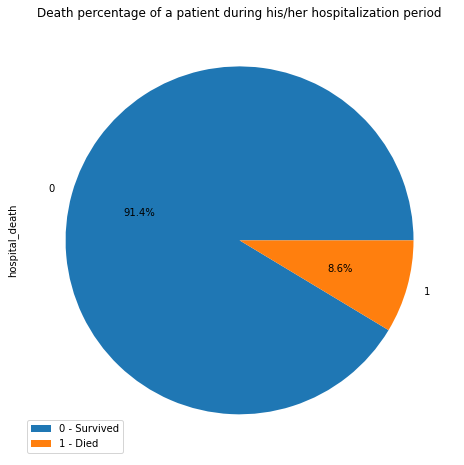

In [20]:
# Target Variable
labels = ['0 - Survived', '1 - Died']
df['hospital_death'].value_counts().plot(kind='pie',autopct='%1.1f%%')
plt.legend(labels, loc="lower left")
plt.title('Death percentage of a patient during his/her hospitalization period')
plt.show()

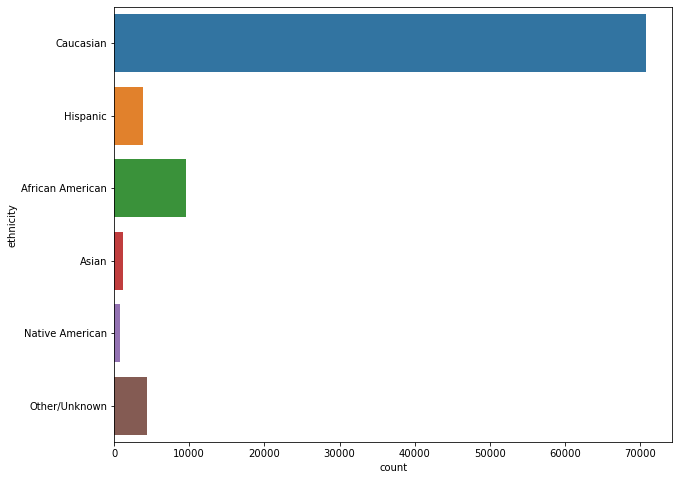

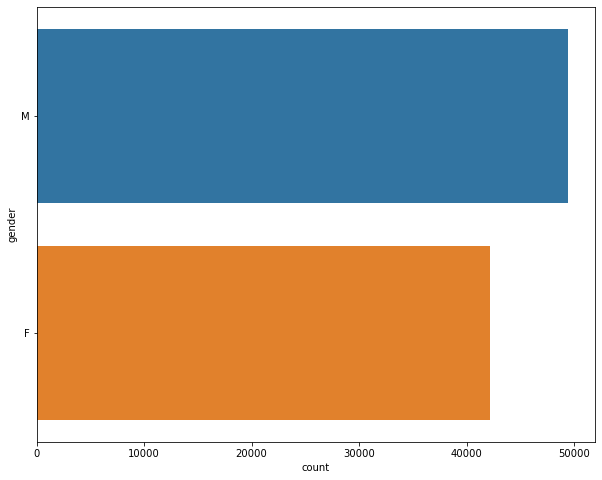

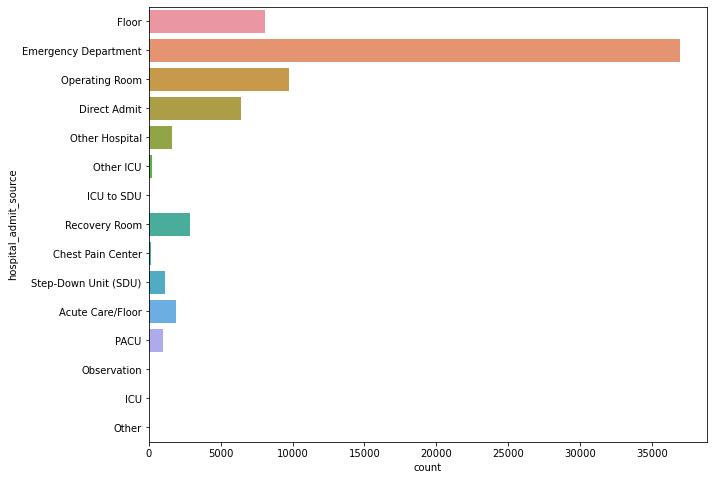

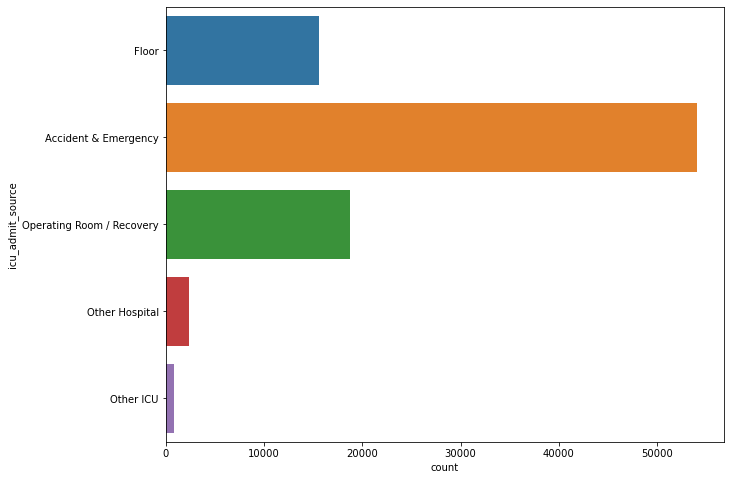

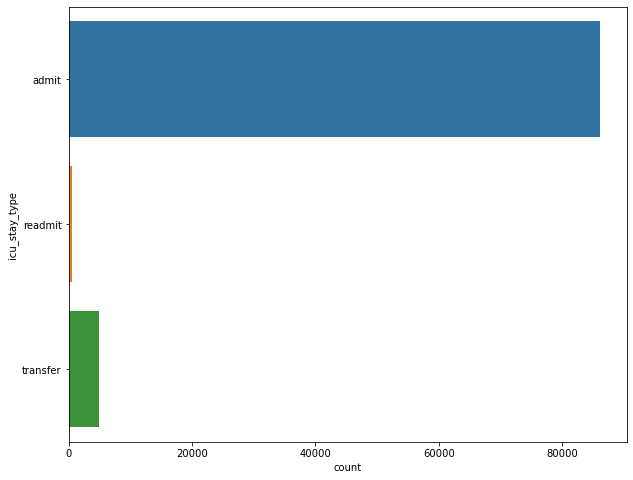

...

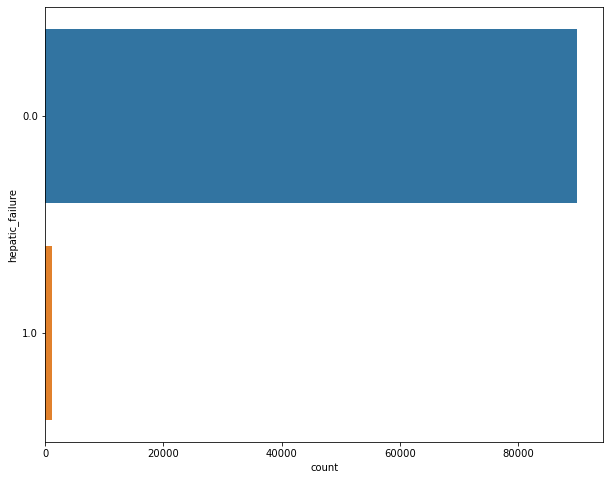

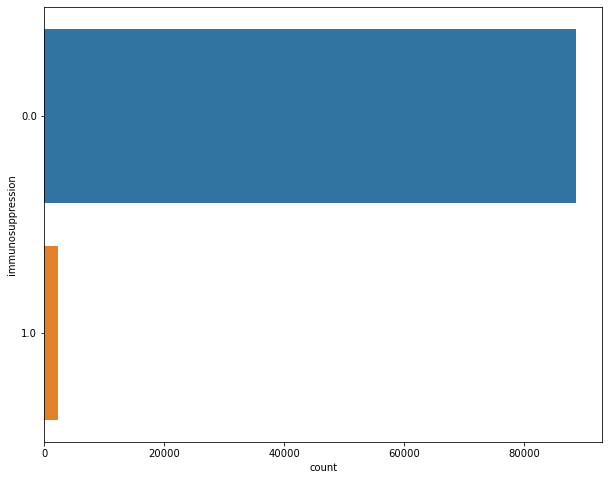

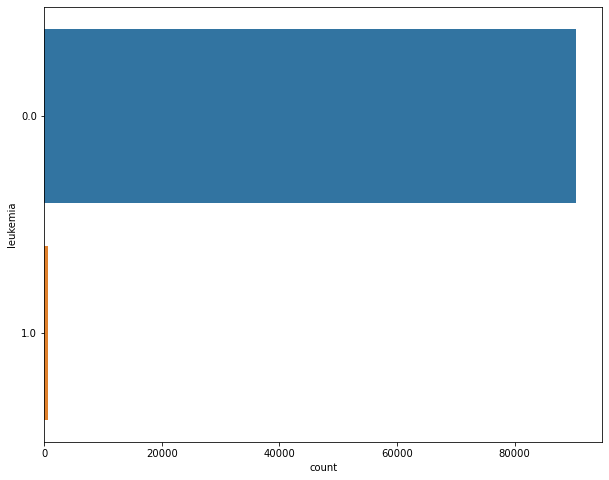

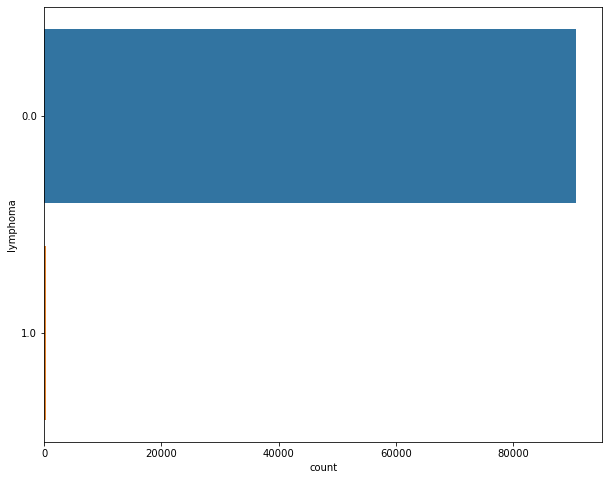

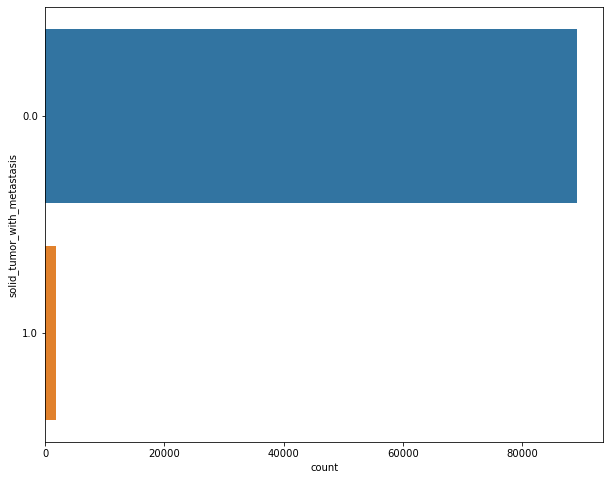

In [21]:
#Categorical Variables
for col in df_cat:
    sns.countplot(y=col, data=df_cat)
    plt.show()

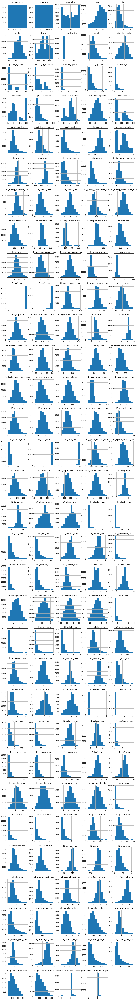

In [22]:
# Numerical values
df_cont.hist(layout=(32,5), figsize=(15,120));

**Multivariate Analysis**

In [23]:
# Gender and hospital death
fig = px.histogram(df, x="gender", color="hospital_death")
fig.show()

<AxesSubplot:xlabel='hospital_death', ylabel='age'>

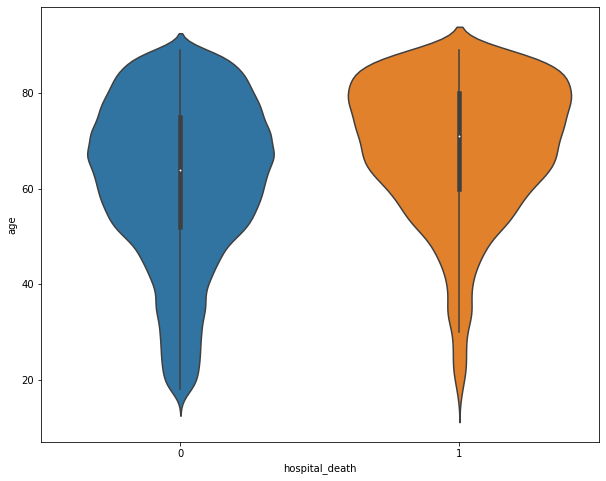

In [24]:
# Age and hospital death
sns.violinplot(data=df, x='hospital_death',y='age')

<AxesSubplot:xlabel='hospital_death', ylabel='bmi'>

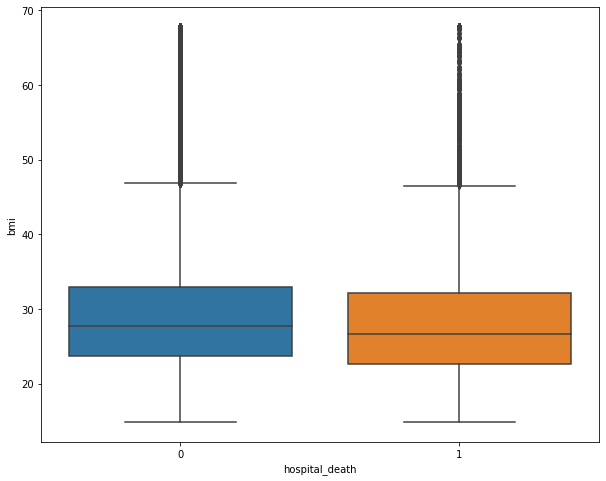

In [25]:
# BMI of most patient who dies in the hospital
sns.boxplot(data=df, x='hospital_death',y='bmi')

In [26]:
# Hospital admit source and hospital death
fig = px.histogram(df, x="hospital_admit_source", color="hospital_death").update_xaxes(categoryorder='total descending')
fig.show()

In [27]:
fig = px.histogram(df, x="icu_admit_source", color="icu_type").update_xaxes(categoryorder='total descending')
fig.show()

In [28]:
fig = px.histogram(df, x="ethnicity", color="hospital_death").update_xaxes(categoryorder='total descending')
fig.show()

In [29]:
fig = px.histogram(df, color="hospital_death", x="icu_type").update_xaxes(categoryorder='total descending')
fig.show()

In [30]:
fig = px.histogram(df, color="hospital_death", x="apache_3j_bodysystem").update_xaxes(categoryorder='total descending')
fig.show()

In [31]:
fig = px.histogram(df, color="hospital_death", x="apache_2_bodysystem").update_xaxes(categoryorder='total descending')
fig.show()

# Data Preprocessing

**Duplicated Values**

In [32]:
print('Duplicate values:', df.duplicated().sum())

Duplicate values: 0


**Missing Values**

In [33]:
# Categorical
missingval = df_cat.isnull().sum()
percentage_missing = 100 * df_cat.isnull().sum()/len(df)
missing_table = pd.concat([missingval,percentage_missing],axis=1)
missing_table = missing_table.rename(columns = {0:'MissingValues', 1:'Percentage'})
missing_table.sort_values(by='MissingValues',ascending=False)

,MissingValues,Percentage
hospital_admit_source,21409,23.343474
gcs_eyes_apache,1901,2.072770
gcs_verbal_apache,1901,2.072770
gcs_motor_apache,1901,2.072770
apache_3j_bodysystem,1662,1.812175
apache_2_bodysystem,1662,1.812175
ethnicity,1395,1.521049
gcs_unable_apache,1037,1.130701
intubated_apache,715,0.779606
ventilated_apache,715,0.779606


In [34]:
column_to_drop = missing_table[missing_table['MissingValues']>20000].index
df_cat.drop(columns=column_to_drop, inplace=True)
df_cat

,ethnicity,gender,icu_admit_source,icu_stay_type,icu_type,apache_3j_bodysystem,apache_2_bodysystem,hospital_death,elective_surgery,readmission_status,...,intubated_apache,ventilated_apache,aids,cirrhosis,diabetes_mellitus,hepatic_failure,immunosuppression,leukemia,lymphoma,solid_tumor_with_metastasis
0,Caucasian,M,Floor,admit,CTICU,Sepsis,Cardiovascular,0,0,0,...,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0
1,Caucasian,F,Floor,admit,Med-Surg ICU,Respiratory,Respiratory,0,0,0,...,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0
2,Caucasian,F,Accident & Emergency,admit,Med-Surg ICU,Metabolic,Metabolic,0,0,0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,Caucasian,F,Operating Room / Recovery,admit,CTICU,Cardiovascular,Cardiovascular,0,1,0,...,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,Caucasian,M,Accident & Emergency,admit,Med-Surg ICU,Trauma,Trauma,0,0,0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
91708,Caucasian,M,Floor,admit,Cardiac ICU,Sepsis,Cardiovascular,0,0,0,...,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0
91709,Caucasian,F,Floor,admit,Med-Surg ICU,Sepsis,Cardiovascular,0,0,0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
91710,Caucasian,M,Accident & Emergency,admit,Med-Surg ICU,Metabolic,Metabolic,0,0,0,...,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0
91711,Caucasian,F,Accident & Emergency,admit,Med-Surg ICU,Respiratory,Respiratory,0,0,0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [35]:
def display_unique_val(df):
    for col in df:
        print(col)
        print(df[col].unique())
        print('---')

In [36]:
display_unique_val(df_cat)

ethnicity
['Caucasian' nan 'Hispanic' 'African American' 'Asian' 'Native American'
 'Other/Unknown']
---
gender
['M' 'F' nan]
---
icu_admit_source
['Floor' 'Accident & Emergency' 'Operating Room / Recovery'
 'Other Hospital' 'Other ICU' nan]
---
icu_stay_type
['admit' 'readmit' 'transfer']
---
icu_type
['CTICU' 'Med-Surg ICU' 'CCU-CTICU' 'Neuro ICU' 'MICU' 'SICU'
 'Cardiac ICU' 'CSICU']
---
apache_3j_bodysystem
['Sepsis' 'Respiratory' 'Metabolic' 'Cardiovascular' 'Trauma'
 'Neurological' 'Gastrointestinal' 'Genitourinary' nan 'Hematological'
 'Musculoskeletal/Skin' 'Gynecological']
---
apache_2_bodysystem
['Cardiovascular' 'Respiratory' 'Metabolic' 'Trauma' 'Neurologic'
 'Gastrointestinal' 'Renal/Genitourinary' nan 'Undefined diagnoses'
 'Haematologic' 'Undefined Diagnoses']
---
hospital_death
[0, 1]
Categories (2, int64): [0, 1]
---
elective_surgery
[0, 1]
Categories (2, int64): [0, 1]
---
readmission_status
[0]
Categories (1, int64): [0]
---
apache_post_operative
[0, 1]
Categories (2

C:\Users\Rocelle Nathalie Ong\anaconda3\lib\site-packages\pandas\io\formats\format.py:1429: FutureWarning:

Index.ravel returning ndarray is deprecated; in a future version this will return a view on self.



In [37]:
missing_cat_col = df_cat.isnull().columns

for col in missing_cat_col:
    mode = df_cat[col].mode()[0]
    df_cat[col].fillna(mode, inplace=True)
    
df_cat.isnull().sum()

ethnicity                      0
gender                         0
icu_admit_source               0
icu_stay_type                  0
icu_type                       0
apache_3j_bodysystem           0
apache_2_bodysystem            0
hospital_death                 0
elective_surgery               0
readmission_status             0
apache_post_operative          0
arf_apache                     0
gcs_eyes_apache                0
gcs_motor_apache               0
gcs_unable_apache              0
gcs_verbal_apache              0
intubated_apache               0
ventilated_apache              0
aids                           0
cirrhosis                      0
diabetes_mellitus              0
hepatic_failure                0
immunosuppression              0
leukemia                       0
lymphoma                       0
solid_tumor_with_metastasis    0
dtype: int64

In [38]:
display_unique_val(df_cat)

ethnicity
['Caucasian' 'Hispanic' 'African American' 'Asian' 'Native American'
 'Other/Unknown']
---
gender
['M' 'F']
---
icu_admit_source
['Floor' 'Accident & Emergency' 'Operating Room / Recovery'
 'Other Hospital' 'Other ICU']
---
icu_stay_type
['admit' 'readmit' 'transfer']
---
icu_type
['CTICU' 'Med-Surg ICU' 'CCU-CTICU' 'Neuro ICU' 'MICU' 'SICU'
 'Cardiac ICU' 'CSICU']
---
apache_3j_bodysystem
['Sepsis' 'Respiratory' 'Metabolic' 'Cardiovascular' 'Trauma'
 'Neurological' 'Gastrointestinal' 'Genitourinary' 'Hematological'
 'Musculoskeletal/Skin' 'Gynecological']
---
apache_2_bodysystem
['Cardiovascular' 'Respiratory' 'Metabolic' 'Trauma' 'Neurologic'
 'Gastrointestinal' 'Renal/Genitourinary' 'Undefined diagnoses'
 'Haematologic' 'Undefined Diagnoses']
---
hospital_death
[0, 1]
Categories (2, int64): [0, 1]
---
elective_surgery
[0, 1]
Categories (2, int64): [0, 1]
---
readmission_status
[0]
Categories (1, int64): [0]
---
apache_post_operative
[0, 1]
Categories (2, int64): [0, 1]
---

In [39]:
# Continuous
missingval_con = df_cont.isnull().sum()
percentage_missing_con = 100 * df_cont.isnull().sum()/len(df)
missing_table_con = pd.concat([missingval_con,percentage_missing_con],axis=1)
missing_table_con = missing_table_con.rename(columns = {0:'MissingValues', 1:'Percentage'})
len(missing_table_con[missing_table_con['MissingValues']>20000].index)

77

In [40]:
columns_to_drop = missing_table_con[missing_table_con['MissingValues']>20000].index
df_cont.drop(columns=columns_to_drop, inplace=True)
df_cont

C:\Users\Rocelle Nathalie Ong\anaconda3\lib\site-packages\pandas\core\frame.py:4906: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



,encounter_id,patient_id,hospital_id,age,bmi,height,icu_id,pre_icu_los_days,weight,apache_2_diagnosis,...,d1_platelets_max,d1_platelets_min,d1_potassium_max,d1_potassium_min,d1_sodium_max,d1_sodium_min,d1_wbc_max,d1_wbc_min,apache_4a_hospital_death_prob,apache_4a_icu_death_prob
0,66154,25312,118,68.0,22.730000,180.3,92,0.541667,73.9,113.0,...,233.0,233.0,4.0,3.4,136.0,134.0,14.10,14.10,0.10,0.05
1,114252,59342,81,77.0,27.420000,160.0,90,0.927778,70.2,108.0,...,557.0,487.0,4.2,3.8,145.0,145.0,23.30,12.70,0.47,0.29
2,119783,50777,118,25.0,31.950000,172.7,93,0.000694,95.3,122.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.00,0.00
3,79267,46918,118,81.0,22.640000,165.1,92,0.000694,61.7,203.0,...,198.0,43.0,5.0,3.5,NaN,NaN,9.00,8.00,0.04,0.03
4,92056,34377,33,19.0,NaN,188.0,91,0.073611,NaN,119.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
91708,91592,78108,30,75.0,23.060250,177.8,927,0.298611,72.9,113.0,...,92.0,92.0,4.2,4.2,140.0,140.0,5.68,5.68,0.12,0.05
91709,66119,13486,121,56.0,47.179671,183.0,925,0.120139,158.0,113.0,...,133.0,133.0,3.8,3.8,136.0,136.0,4.22,4.22,0.03,0.02
91710,8981,58179,195,48.0,27.236914,170.2,908,0.046528,78.9,123.0,...,227.0,227.0,4.7,3.2,139.0,135.0,17.55,17.55,0.05,0.02
91711,33776,120598,66,NaN,23.297481,154.9,922,0.081944,55.9,108.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.07,0.02


In [41]:
df_cont = df_cont[df_cont[['bmi','height','weight']].isna().sum(axis=1)==0]
df_cont

,encounter_id,patient_id,hospital_id,age,bmi,height,icu_id,pre_icu_los_days,weight,apache_2_diagnosis,...,d1_platelets_max,d1_platelets_min,d1_potassium_max,d1_potassium_min,d1_sodium_max,d1_sodium_min,d1_wbc_max,d1_wbc_min,apache_4a_hospital_death_prob,apache_4a_icu_death_prob
0,66154,25312,118,68.0,22.730000,180.3,92,0.541667,73.9,113.0,...,233.0,233.0,4.0,3.4,136.0,134.0,14.10,14.10,0.10,0.05
1,114252,59342,81,77.0,27.420000,160.0,90,0.927778,70.2,108.0,...,557.0,487.0,4.2,3.8,145.0,145.0,23.30,12.70,0.47,0.29
2,119783,50777,118,25.0,31.950000,172.7,93,0.000694,95.3,122.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.00,0.00
3,79267,46918,118,81.0,22.640000,165.1,92,0.000694,61.7,203.0,...,198.0,43.0,5.0,3.5,NaN,NaN,9.00,8.00,0.04,0.03
5,33181,74489,83,67.0,27.560000,190.5,95,0.000694,100.0,301.0,...,159.0,159.0,3.9,3.7,137.0,137.0,10.90,10.90,0.05,0.02
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
91708,91592,78108,30,75.0,23.060250,177.8,927,0.298611,72.9,113.0,...,92.0,92.0,4.2,4.2,140.0,140.0,5.68,5.68,0.12,0.05
91709,66119,13486,121,56.0,47.179671,183.0,925,0.120139,158.0,113.0,...,133.0,133.0,3.8,3.8,136.0,136.0,4.22,4.22,0.03,0.02
91710,8981,58179,195,48.0,27.236914,170.2,908,0.046528,78.9,123.0,...,227.0,227.0,4.7,3.2,139.0,135.0,17.55,17.55,0.05,0.02
91711,33776,120598,66,NaN,23.297481,154.9,922,0.081944,55.9,108.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.07,0.02


In [42]:
missing_cont_col = df_cont.isnull().columns

for col in missing_cont_col:
    mean = df_cont[col].mean()
    df_cont[col].fillna(mean, inplace=True)
    
df_cont.isnull().sum()

C:\Users\Rocelle Nathalie Ong\anaconda3\lib\site-packages\pandas\core\generic.py:6392: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



encounter_id                     0
patient_id                       0
hospital_id                      0
age                              0
bmi                              0
                                ..
d1_sodium_min                    0
d1_wbc_max                       0
d1_wbc_min                       0
apache_4a_hospital_death_prob    0
apache_4a_icu_death_prob         0
Length: 82, dtype: int64

In [43]:
df_cont.isnull().sum().any()

False

**Encode Categorical to Numerical Values**

In [44]:
col = df_cat.dtypes.loc[df.dtypes=='object'].index

for i in col:
    df_cat[i+'_enc'] = LabelEncoder().fit_transform(df_cat[i])
    df_cat.drop(columns=i, inplace=True)
df_cat.head()

,hospital_death,elective_surgery,readmission_status,apache_post_operative,arf_apache,gcs_eyes_apache,gcs_motor_apache,gcs_unable_apache,gcs_verbal_apache,intubated_apache,...,leukemia,lymphoma,solid_tumor_with_metastasis,ethnicity_enc,gender_enc,icu_admit_source_enc,icu_stay_type_enc,icu_type_enc,apache_3j_bodysystem_enc,apache_2_bodysystem_enc
0,0,0,0,0,0.0,3.0,6.0,0.0,4.0,0.0,...,0.0,0.0,0.0,2,1,1,0,2,9,0
1,0,0,0,0,0.0,1.0,3.0,0.0,1.0,0.0,...,0.0,0.0,0.0,2,0,1,0,5,8,6
2,0,0,0,0,0.0,3.0,6.0,0.0,5.0,0.0,...,0.0,0.0,0.0,2,0,0,0,5,5,3
3,0,1,0,1,0.0,4.0,6.0,0.0,5.0,1.0,...,0.0,0.0,0.0,2,0,2,0,2,0,0
4,0,0,0,0,0.0,4.0,6.0,0.0,5.0,0.0,...,0.0,0.0,0.0,2,1,0,0,5,10,7


In [45]:
display_unique_val(df_cat)

hospital_death
[0, 1]
Categories (2, int64): [0, 1]
---
elective_surgery
[0, 1]
Categories (2, int64): [0, 1]
---
readmission_status
[0]
Categories (1, int64): [0]
---
apache_post_operative
[0, 1]
Categories (2, int64): [0, 1]
---
arf_apache
[0.0, 1.0]
Categories (2, float64): [0.0, 1.0]
---
gcs_eyes_apache
[3.0, 1.0, 4.0, 2.0]
Categories (4, float64): [1.0, 2.0, 3.0, 4.0]
---
gcs_motor_apache
[6.0, 3.0, 4.0, 5.0, 1.0, 2.0]
Categories (6, float64): [1.0, 2.0, 3.0, 4.0, 5.0, 6.0]
---
gcs_unable_apache
[0.0, 1.0]
Categories (2, float64): [0.0, 1.0]
---
gcs_verbal_apache
[4.0, 1.0, 5.0, 3.0, 2.0]
Categories (5, float64): [1.0, 2.0, 3.0, 4.0, 5.0]
---
intubated_apache
[0.0, 1.0]
Categories (2, float64): [0.0, 1.0]
---
ventilated_apache
[0.0, 1.0]
Categories (2, float64): [0.0, 1.0]
---
aids
[0.0, 1.0]
Categories (2, float64): [0.0, 1.0]
---
cirrhosis
[0.0, 1.0]
Categories (2, float64): [0.0, 1.0]
---
diabetes_mellitus
[1.0, 0.0]
Categories (2, float64): [0.0, 1.0]
---
hepatic_failure
[0.0,

C:\Users\Rocelle Nathalie Ong\anaconda3\lib\site-packages\pandas\io\formats\format.py:1429: FutureWarning:

Index.ravel returning ndarray is deprecated; in a future version this will return a view on self.



In [46]:
df_cat.columns = df_cat.columns.str.rstrip("_enc")
df_cat.head()

,hospital_death,elective_surgery,readmission_status,apache_post_operativ,arf_apach,gcs_eyes_apach,gcs_motor_apach,gcs_unable_apach,gcs_verbal_apach,intubated_apach,...,leukemia,lymphoma,solid_tumor_with_metastasis,ethnicity,gender,icu_admit_sour,icu_stay_typ,icu_typ,apache_3j_bodysystem,apache_2_bodysystem
0,0,0,0,0,0.0,3.0,6.0,0.0,4.0,0.0,...,0.0,0.0,0.0,2,1,1,0,2,9,0
1,0,0,0,0,0.0,1.0,3.0,0.0,1.0,0.0,...,0.0,0.0,0.0,2,0,1,0,5,8,6
2,0,0,0,0,0.0,3.0,6.0,0.0,5.0,0.0,...,0.0,0.0,0.0,2,0,0,0,5,5,3
3,0,1,0,1,0.0,4.0,6.0,0.0,5.0,1.0,...,0.0,0.0,0.0,2,0,2,0,2,0,0
4,0,0,0,0,0.0,4.0,6.0,0.0,5.0,0.0,...,0.0,0.0,0.0,2,1,0,0,5,10,7


**Feature Engineering**

In [47]:
df_new = pd.concat([df_cat,df_cont],axis=1)
df_new

,hospital_death,elective_surgery,readmission_status,apache_post_operativ,arf_apach,gcs_eyes_apach,gcs_motor_apach,gcs_unable_apach,gcs_verbal_apach,intubated_apach,...,d1_platelets_max,d1_platelets_min,d1_potassium_max,d1_potassium_min,d1_sodium_max,d1_sodium_min,d1_wbc_max,d1_wbc_min,apache_4a_hospital_death_prob,apache_4a_icu_death_prob
0,0,0,0,0,0.0,3.0,6.0,0.0,4.0,0.0,...,233.0000,233.000000,4.000000,3.400000,136.000000,134.000000,14.100000,14.10000,0.10,0.05
1,0,0,0,0,0.0,1.0,3.0,0.0,1.0,0.0,...,557.0000,487.000000,4.200000,3.800000,145.000000,145.000000,23.300000,12.70000,0.47,0.29
2,0,0,0,0,0.0,3.0,6.0,0.0,5.0,0.0,...,207.0948,196.691924,4.252817,3.934218,139.118424,137.702653,12.498696,11.32823,0.00,0.00
3,0,1,0,1,0.0,4.0,6.0,0.0,5.0,1.0,...,198.0000,43.000000,5.000000,3.500000,139.118424,137.702653,9.000000,8.00000,0.04,0.03
4,0,0,0,0,0.0,4.0,6.0,0.0,5.0,0.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
91708,0,0,0,0,0.0,4.0,6.0,0.0,5.0,0.0,...,92.0000,92.000000,4.200000,4.200000,140.000000,140.000000,5.680000,5.68000,0.12,0.05
91709,0,0,0,0,0.0,4.0,6.0,0.0,5.0,0.0,...,133.0000,133.000000,3.800000,3.800000,136.000000,136.000000,4.220000,4.22000,0.03,0.02
91710,0,0,0,0,0.0,3.0,6.0,0.0,4.0,0.0,...,227.0000,227.000000,4.700000,3.200000,139.000000,135.000000,17.550000,17.55000,0.05,0.02
91711,0,0,0,0,0.0,4.0,5.0,0.0,4.0,0.0,...,207.0948,196.691924,4.252817,3.934218,139.118424,137.702653,12.498696,11.32823,0.07,0.02


In [48]:
df_new.isnull().any()

hospital_death                   False
elective_surgery                 False
readmission_status               False
apache_post_operativ             False
arf_apach                        False
                                 ...  
d1_sodium_min                     True
d1_wbc_max                        True
d1_wbc_min                        True
apache_4a_hospital_death_prob     True
apache_4a_icu_death_prob          True
Length: 108, dtype: bool

In [49]:
df_new.dropna(axis=0,inplace=True)

In [50]:
df_new.shape

(88284, 108)

In [51]:
df_cont.columns

Index(['encounter_id', 'patient_id', 'hospital_id', 'age', 'bmi', 'height',
       'icu_id', 'pre_icu_los_days', 'weight', 'apache_2_diagnosis',
       'apache_3j_diagnosis', 'bun_apache', 'creatinine_apache',
       'glucose_apache', 'heart_rate_apache', 'hematocrit_apache',
       'map_apache', 'resprate_apache', 'sodium_apache', 'temp_apache',
       'd1_diasbp_max', 'd1_diasbp_min', 'd1_diasbp_noninvasive_max',
       'd1_diasbp_noninvasive_min', 'd1_heartrate_max', 'd1_heartrate_min',
       'd1_mbp_max', 'd1_mbp_min', 'd1_mbp_noninvasive_max',
       'd1_mbp_noninvasive_min', 'd1_resprate_max', 'd1_resprate_min',
       'd1_spo2_max', 'd1_spo2_min', 'd1_sysbp_max', 'd1_sysbp_min',
       'd1_sysbp_noninvasive_max', 'd1_sysbp_noninvasive_min', 'd1_temp_max',
       'd1_temp_min', 'h1_diasbp_max', 'h1_diasbp_min',
       'h1_diasbp_noninvasive_max', 'h1_diasbp_noninvasive_min',
       'h1_heartrate_max', 'h1_heartrate_min', 'h1_mbp_max', 'h1_mbp_min',
       'h1_mbp_noninvasive_max

In [52]:
df_new.drop(columns=['encounter_id', 'patient_id', 'hospital_id','icu_id'],inplace=True)

In [53]:
print(df_new.shape)

(88284, 104)


In [54]:
# Splitting X and Y variables
y = df_new['hospital_death']
X = df_new.drop(columns='hospital_death',axis=1)

In [55]:
X.head()

,elective_surgery,readmission_status,apache_post_operativ,arf_apach,gcs_eyes_apach,gcs_motor_apach,gcs_unable_apach,gcs_verbal_apach,intubated_apach,ventilated_apach,...,d1_platelets_max,d1_platelets_min,d1_potassium_max,d1_potassium_min,d1_sodium_max,d1_sodium_min,d1_wbc_max,d1_wbc_min,apache_4a_hospital_death_prob,apache_4a_icu_death_prob
0,0,0,0,0.0,3.0,6.0,0.0,4.0,0.0,0.0,...,233.0000,233.000000,4.000000,3.400000,136.000000,134.000000,14.100000,14.10000,0.10,0.05
1,0,0,0,0.0,1.0,3.0,0.0,1.0,0.0,1.0,...,557.0000,487.000000,4.200000,3.800000,145.000000,145.000000,23.300000,12.70000,0.47,0.29
2,0,0,0,0.0,3.0,6.0,0.0,5.0,0.0,0.0,...,207.0948,196.691924,4.252817,3.934218,139.118424,137.702653,12.498696,11.32823,0.00,0.00
3,1,0,1,0.0,4.0,6.0,0.0,5.0,1.0,1.0,...,198.0000,43.000000,5.000000,3.500000,139.118424,137.702653,9.000000,8.00000,0.04,0.03
5,0,0,0,0.0,4.0,6.0,0.0,5.0,0.0,0.0,...,159.0000,159.000000,3.900000,3.700000,137.000000,137.000000,10.900000,10.90000,0.05,0.02


In [56]:
y.value_counts()

0    80732
1     7552
Name: hospital_death, dtype: int64

In [57]:
# Splitting the dataset into train and test data
from sklearn.model_selection import train_test_split

X_train, X_test, y_train, y_test = train_test_split(X, y,  test_size=0.2, shuffle = True, random_state = 8)

In [58]:
X_train.shape, X_test.shape

((70627, 103), (17657, 103))

**Normalization**

In [59]:
# creating an instance for MinMaxScaler
scaler = MinMaxScaler()
X_train_sc= scaler.fit_transform(X_train)
X_test_sc = scaler.transform(X_test)

In [60]:
# storing the normalized data into a new dataframe
X_train_new = pd.DataFrame(X_train_sc, columns= X_train.columns)
X_test_new = pd.DataFrame(X_test_sc, columns= X_test.columns)

In [61]:
X_test_new.head()

,elective_surgery,readmission_status,apache_post_operativ,arf_apach,gcs_eyes_apach,gcs_motor_apach,gcs_unable_apach,gcs_verbal_apach,intubated_apach,ventilated_apach,...,d1_platelets_max,d1_platelets_min,d1_potassium_max,d1_potassium_min,d1_sodium_max,d1_sodium_min,d1_wbc_max,d1_wbc_min,apache_4a_hospital_death_prob,apache_4a_icu_death_prob
0,0.0,0.0,0.0,0.0,1.000000,1.0,0.0,1.0,0.0,0.0,...,0.311828,0.338560,0.285714,0.470588,0.457143,0.611111,0.142602,0.167508,0.547739,0.532995
1,0.0,0.0,0.0,0.0,0.666667,1.0,0.0,1.0,0.0,0.0,...,0.191756,0.214233,0.690476,0.588235,0.571429,0.555556,0.251783,0.290015,0.567839,0.543147
2,0.0,0.0,0.0,0.0,1.000000,1.0,0.0,1.0,0.0,0.0,...,0.372760,0.353405,0.345909,0.451241,0.460526,0.575074,0.166444,0.161508,0.517588,0.512690
3,0.0,0.0,0.0,1.0,0.666667,0.8,0.0,0.0,0.0,0.0,...,0.322751,0.330566,0.345909,0.451241,0.460526,0.575074,0.251753,0.260719,0.542714,0.522843
4,0.0,0.0,0.0,0.0,0.666667,1.0,0.0,0.0,1.0,1.0,...,0.369176,0.397940,0.404762,0.529412,0.800000,0.861111,0.342914,0.392270,0.698492,0.644670


# Model Development

In [62]:
epochs = 500
batch_size = 32

### Model #1 - Baseline NN

In [63]:
model = Sequential()
model.add(Dense(103, input_shape=(X_train_new.shape[-1],), activation='relu'))
model.add(Dense(51, activation='relu'))
model.add(Dense(20, activation='relu'))
model.add(Dense(1, activation='sigmoid'))

model.compile(optimizer=Adam(0.001),
              loss='binary_crossentropy',
              metrics='accuracy')

history = model.fit(X_train_new.values,y_train, 
                    validation_data = (X_test_new.values, y_test), epochs=epochs, batch_size=batch_size)

Epoch 1/500
2208/2208 [==============================] - 6s 2ms/step - loss: 0.2198 - accuracy: 0.9202 - val_loss: 0.2155 - val_accuracy: 0.9213
Epoch 2/500
2208/2208 [==============================] - 6s 3ms/step - loss: 0.2078 - accuracy: 0.9243 - val_loss: 0.2086 - val_accuracy: 0.9253
Epoch 3/500
2208/2208 [==============================] - 6s 3ms/step - loss: 0.2043 - accuracy: 0.9252 - val_loss: 0.2058 - val_accuracy: 0.9241
Epoch 4/500
2208/2208 [==============================] - 6s 3ms/step - loss: 0.2014 - accuracy: 0.9263 - val_loss: 0.2016 - val_accuracy: 0.9261
Epoch 5/500
2208/2208 [==============================] - 8s 3ms/step - loss: 0.1999 - accuracy: 0.9273 - val_loss: 0.2106 - val_accuracy: 0.9177
Epoch 6/500
2208/2208 [==============================] - 9s 4ms/step - loss: 0.1985 - accuracy: 0.9275 - val_loss: 0.2023 - val_accuracy: 0.9260
Epoch 7/500
2208/2208 [==============================] - 7s 3ms/step - loss: 0.1972 - accuracy: 0.9278 - val_loss: 0.2003 - val_ac

2208/2208 [==============================] - 2s 1ms/step - loss: 0.1436 - accuracy: 0.9488 - val_loss: 0.2653 - val_accuracy: 0.9190
Epoch 58/500
2208/2208 [==============================] - 2s 1ms/step - loss: 0.1426 - accuracy: 0.9492 - val_loss: 0.2605 - val_accuracy: 0.9154
Epoch 59/500
2208/2208 [==============================] - 2s 1ms/step - loss: 0.1421 - accuracy: 0.9490 - val_loss: 0.2792 - val_accuracy: 0.9207
Epoch 60/500
2208/2208 [==============================] - 2s 1ms/step - loss: 0.1425 - accuracy: 0.9494 - val_loss: 0.2687 - val_accuracy: 0.9200
Epoch 61/500
2208/2208 [==============================] - 2s 1ms/step - loss: 0.1410 - accuracy: 0.9496 - val_loss: 0.2708 - val_accuracy: 0.9184
Epoch 62/500
2208/2208 [==============================] - 2s 1ms/step - loss: 0.1398 - accuracy: 0.9505 - val_loss: 0.2855 - val_accuracy: 0.9147
Epoch 63/500
2208/2208 [==============================] - 2s 1ms/step - loss: 0.1395 - accuracy: 0.9502 - val_loss: 0.2688 - val_accuracy

Epoch 113/500
2208/2208 [==============================] - 2s 1ms/step - loss: 0.1131 - accuracy: 0.9598 - val_loss: 0.4005 - val_accuracy: 0.9110
Epoch 114/500
2208/2208 [==============================] - 2s 989us/step - loss: 0.1106 - accuracy: 0.9609 - val_loss: 0.4109 - val_accuracy: 0.9165
Epoch 115/500
2208/2208 [==============================] - 2s 1ms/step - loss: 0.1119 - accuracy: 0.9607 - val_loss: 0.4011 - val_accuracy: 0.9125
Epoch 116/500
2208/2208 [==============================] - 2s 1ms/step - loss: 0.1118 - accuracy: 0.9614 - val_loss: 0.4080 - val_accuracy: 0.9126
Epoch 117/500
2208/2208 [==============================] - 2s 1ms/step - loss: 0.1115 - accuracy: 0.9609 - val_loss: 0.4069 - val_accuracy: 0.9166
Epoch 118/500
2208/2208 [==============================] - 2s 1ms/step - loss: 0.1101 - accuracy: 0.9619 - val_loss: 0.4095 - val_accuracy: 0.9110
Epoch 119/500
2208/2208 [==============================] - 2s 1ms/step - loss: 0.1104 - accuracy: 0.9612 - val_loss:

2208/2208 [==============================] - 3s 1ms/step - loss: 0.0972 - accuracy: 0.9660 - val_loss: 0.5322 - val_accuracy: 0.9109
Epoch 169/500
2208/2208 [==============================] - 3s 1ms/step - loss: 0.0985 - accuracy: 0.9655 - val_loss: 0.5272 - val_accuracy: 0.9076
Epoch 170/500
2208/2208 [==============================] - 3s 1ms/step - loss: 0.0969 - accuracy: 0.9658 - val_loss: 0.5099 - val_accuracy: 0.9130
Epoch 171/500
2208/2208 [==============================] - 3s 1ms/step - loss: 0.0973 - accuracy: 0.9664 - val_loss: 0.5264 - val_accuracy: 0.9036
Epoch 172/500
2208/2208 [==============================] - 3s 2ms/step - loss: 0.0972 - accuracy: 0.9659 - val_loss: 0.5295 - val_accuracy: 0.9124
Epoch 173/500
2208/2208 [==============================] - 3s 1ms/step - loss: 0.0961 - accuracy: 0.9664 - val_loss: 0.5359 - val_accuracy: 0.9104
Epoch 174/500
2208/2208 [==============================] - 3s 1ms/step - loss: 0.0962 - accuracy: 0.9663 - val_loss: 0.5661 - val_ac

Epoch 224/500
2208/2208 [==============================] - 2s 1ms/step - loss: 0.0875 - accuracy: 0.9701 - val_loss: 0.6593 - val_accuracy: 0.9054
Epoch 225/500
2208/2208 [==============================] - 2s 1ms/step - loss: 0.0881 - accuracy: 0.9698 - val_loss: 0.6367 - val_accuracy: 0.9086
Epoch 226/500
2208/2208 [==============================] - 2s 1ms/step - loss: 0.0831 - accuracy: 0.9712 - val_loss: 0.6658 - val_accuracy: 0.9090
Epoch 227/500
2208/2208 [==============================] - 2s 1ms/step - loss: 0.0852 - accuracy: 0.9706 - val_loss: 0.6690 - val_accuracy: 0.9100
Epoch 228/500
2208/2208 [==============================] - 2s 1ms/step - loss: 0.0840 - accuracy: 0.9711 - val_loss: 0.6809 - val_accuracy: 0.9048
Epoch 229/500
2208/2208 [==============================] - 2s 1ms/step - loss: 0.0879 - accuracy: 0.9696 - val_loss: 0.6721 - val_accuracy: 0.9050
Epoch 230/500
2208/2208 [==============================] - 2s 1ms/step - loss: 0.0845 - accuracy: 0.9711 - val_loss: 0

Epoch 280/500
2208/2208 [==============================] - 2s 1ms/step - loss: 0.0781 - accuracy: 0.9731 - val_loss: 0.7763 - val_accuracy: 0.9076
Epoch 281/500
2208/2208 [==============================] - 2s 1ms/step - loss: 0.0794 - accuracy: 0.9726 - val_loss: 0.7958 - val_accuracy: 0.9072
Epoch 282/500
2208/2208 [==============================] - 2s 1ms/step - loss: 0.0784 - accuracy: 0.9734 - val_loss: 0.7686 - val_accuracy: 0.9039
Epoch 283/500
2208/2208 [==============================] - 2s 989us/step - loss: 0.0781 - accuracy: 0.9733 - val_loss: 0.8015 - val_accuracy: 0.9088
Epoch 284/500
2208/2208 [==============================] - 2s 1ms/step - loss: 0.0808 - accuracy: 0.9728 - val_loss: 0.7847 - val_accuracy: 0.9079
Epoch 285/500
2208/2208 [==============================] - 2s 1ms/step - loss: 0.0790 - accuracy: 0.9733 - val_loss: 0.7404 - val_accuracy: 0.9066
Epoch 286/500
2208/2208 [==============================] - 2s 1ms/step - loss: 0.0809 - accuracy: 0.9726 - val_loss:

Epoch 336/500
2208/2208 [==============================] - 3s 1ms/step - loss: 0.0748 - accuracy: 0.9747 - val_loss: 0.9392 - val_accuracy: 0.9019
Epoch 337/500
2208/2208 [==============================] - 2s 1ms/step - loss: 0.0736 - accuracy: 0.9758 - val_loss: 0.8390 - val_accuracy: 0.9027
Epoch 338/500
2208/2208 [==============================] - 2s 1ms/step - loss: 0.0701 - accuracy: 0.9761 - val_loss: 0.8909 - val_accuracy: 0.9055
Epoch 339/500
2208/2208 [==============================] - 2s 1ms/step - loss: 0.0742 - accuracy: 0.9750 - val_loss: 0.8621 - val_accuracy: 0.9048
Epoch 340/500
2208/2208 [==============================] - 3s 1ms/step - loss: 0.0750 - accuracy: 0.9748 - val_loss: 0.8714 - val_accuracy: 0.9046
Epoch 341/500
2208/2208 [==============================] - 3s 1ms/step - loss: 0.0717 - accuracy: 0.9764 - val_loss: 0.8638 - val_accuracy: 0.9033
Epoch 342/500
2208/2208 [==============================] - 2s 1ms/step - loss: 0.0735 - accuracy: 0.9753 - val_loss: 0

Epoch 392/500
2208/2208 [==============================] - 2s 1ms/step - loss: 0.0678 - accuracy: 0.9771 - val_loss: 0.9510 - val_accuracy: 0.9071
Epoch 393/500
2208/2208 [==============================] - 2s 1ms/step - loss: 0.0682 - accuracy: 0.9764 - val_loss: 0.9766 - val_accuracy: 0.9019
Epoch 394/500
2208/2208 [==============================] - 2s 1ms/step - loss: 0.0681 - accuracy: 0.9769 - val_loss: 0.9295 - val_accuracy: 0.9024
Epoch 395/500
2208/2208 [==============================] - 2s 1ms/step - loss: 0.0676 - accuracy: 0.9770 - val_loss: 0.9482 - val_accuracy: 0.9046
Epoch 396/500
2208/2208 [==============================] - 2s 1ms/step - loss: 0.0673 - accuracy: 0.9774 - val_loss: 0.9478 - val_accuracy: 0.9022
Epoch 397/500
2208/2208 [==============================] - 2s 1ms/step - loss: 0.0672 - accuracy: 0.9774 - val_loss: 0.8929 - val_accuracy: 0.9072
Epoch 398/500
2208/2208 [==============================] - 2s 1ms/step - loss: 0.0690 - accuracy: 0.9766 - val_loss: 0

Epoch 448/500
2208/2208 [==============================] - 2s 1ms/step - loss: 0.0620 - accuracy: 0.9785 - val_loss: 1.0234 - val_accuracy: 0.9034
Epoch 449/500
2208/2208 [==============================] - 2s 1ms/step - loss: 0.0628 - accuracy: 0.9782 - val_loss: 1.0147 - val_accuracy: 0.8996
Epoch 450/500
2208/2208 [==============================] - 2s 1ms/step - loss: 0.0671 - accuracy: 0.9774 - val_loss: 1.0540 - val_accuracy: 0.8962
Epoch 451/500
2208/2208 [==============================] - 2s 1ms/step - loss: 0.0646 - accuracy: 0.9783 - val_loss: 1.0495 - val_accuracy: 0.8985
Epoch 452/500
2208/2208 [==============================] - 3s 1ms/step - loss: 0.0658 - accuracy: 0.9779 - val_loss: 1.0346 - val_accuracy: 0.9034
Epoch 453/500
2208/2208 [==============================] - 2s 1ms/step - loss: 0.0664 - accuracy: 0.9782 - val_loss: 1.0524 - val_accuracy: 0.9033
Epoch 454/500
2208/2208 [==============================] - 2s 1ms/step - loss: 0.0644 - accuracy: 0.9783 - val_loss: 1

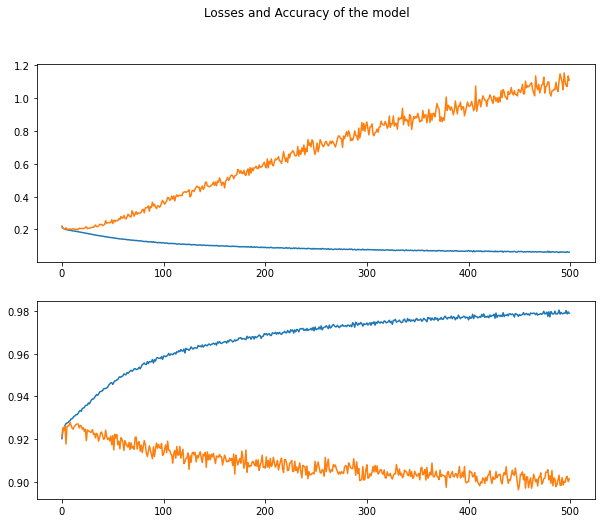

In [64]:
df_result_1 = pd.DataFrame(model.history.history)

fig, (ax1, ax2) = plt.subplots(2)
fig.suptitle('Losses and Accuracy of the model')
ax1.plot(df_result_1[['loss','val_loss']])
ax2.plot(df_result_1[['accuracy','val_accuracy']])
plt.show()

It seems the model is experiencing overfitting. We will modify the model by adding callbacks and Dropout and evaluate the result

### Model #2 - Adding callbacks

In [65]:
model = Sequential()
model.add(Dense(103, input_shape=(X_train_new.shape[-1],), activation='relu'))
model.add(Dense(51, activation='relu'))
model.add(Dense(20, activation='relu'))
model.add(Dense(1, activation='sigmoid'))

model.compile(optimizer=Adam(0.001),
              loss='binary_crossentropy',
              metrics='accuracy')

early_stop = EarlyStopping(monitor='val_loss',mode='min', verbose = 1, patience=25)
model.fit(X_train_new.values,y_train, 
                    validation_data = (X_test_new.values, y_test), epochs=epochs, batch_size=batch_size, callbacks = [early_stop])

Epoch 1/500
2208/2208 [==============================] - 3s 1ms/step - loss: 0.2177 - accuracy: 0.9212 - val_loss: 0.2105 - val_accuracy: 0.9235
Epoch 2/500
2208/2208 [==============================] - 3s 1ms/step - loss: 0.2083 - accuracy: 0.9242 - val_loss: 0.2121 - val_accuracy: 0.9237
Epoch 3/500
2208/2208 [==============================] - 3s 2ms/step - loss: 0.2044 - accuracy: 0.9253 - val_loss: 0.2099 - val_accuracy: 0.9238
Epoch 4/500
2208/2208 [==============================] - 3s 1ms/step - loss: 0.2022 - accuracy: 0.9266 - val_loss: 0.2059 - val_accuracy: 0.9243
Epoch 5/500
2208/2208 [==============================] - 3s 1ms/step - loss: 0.2003 - accuracy: 0.9271 - val_loss: 0.2150 - val_accuracy: 0.9251
Epoch 6/500
2208/2208 [==============================] - 3s 1ms/step - loss: 0.1980 - accuracy: 0.9282 - val_loss: 0.2018 - val_accuracy: 0.9266
Epoch 7/500
2208/2208 [==============================] - 3s 2ms/step - loss: 0.1972 - accuracy: 0.9282 - val_loss: 0.2005 - val_ac

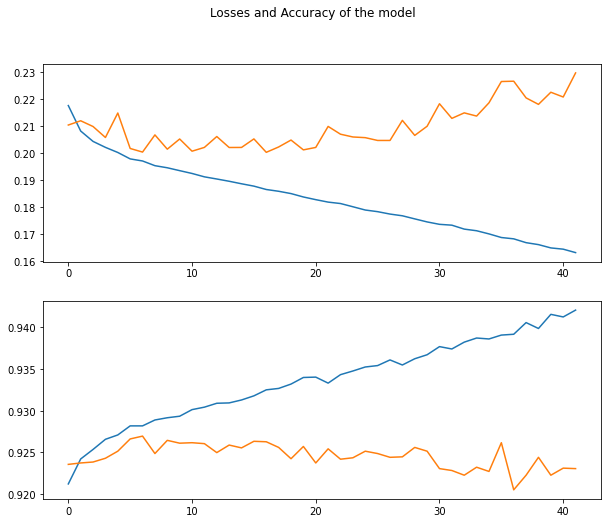

In [66]:
df_result_2 = pd.DataFrame(model.history.history)

fig, (ax1, ax2) = plt.subplots(2)
fig.suptitle('Losses and Accuracy of the model')
ax1.plot(df_result_2[['loss','val_loss']])
ax2.plot(df_result_2[['accuracy','val_accuracy']])

### Model #3 - Adding Dropouts

In [67]:
model = Sequential()
model.add(Dense(103, input_shape=(X_train_new.shape[-1],), activation='relu'))
model.add(Dropout(0.4))
model.add(Dense(51, activation='relu'))
model.add(Dropout(0.4))
model.add(Dense(20, activation='relu'))
model.add(Dropout(0.4))
model.add(Dense(1, activation='sigmoid'))

model.compile(optimizer=Adam(0.001),
              loss='binary_crossentropy',
              metrics='accuracy')

early_stop = EarlyStopping(monitor='val_loss',mode='min', verbose = 1, patience=25)
model.fit(X_train_new.values,y_train, 
                    validation_data = (X_test_new.values, y_test), epochs=epochs, batch_size=batch_size, callbacks = [early_stop])

Epoch 1/500
2208/2208 [==============================] - 4s 2ms/step - loss: 0.2478 - accuracy: 0.9152 - val_loss: 0.2150 - val_accuracy: 0.9218
Epoch 2/500
2208/2208 [==============================] - 4s 2ms/step - loss: 0.2249 - accuracy: 0.9195 - val_loss: 0.2129 - val_accuracy: 0.9201
Epoch 3/500
2208/2208 [==============================] - 4s 2ms/step - loss: 0.2198 - accuracy: 0.9206 - val_loss: 0.2129 - val_accuracy: 0.9239
Epoch 4/500
2208/2208 [==============================] - 4s 2ms/step - loss: 0.2177 - accuracy: 0.9214 - val_loss: 0.2082 - val_accuracy: 0.9232
Epoch 5/500
2208/2208 [==============================] - 4s 2ms/step - loss: 0.2155 - accuracy: 0.9221 - val_loss: 0.2063 - val_accuracy: 0.9240
Epoch 6/500
2208/2208 [==============================] - 4s 2ms/step - loss: 0.2148 - accuracy: 0.9216 - val_loss: 0.2044 - val_accuracy: 0.9251
Epoch 7/500
2208/2208 [==============================] - 4s 2ms/step - loss: 0.2134 - accuracy: 0.9233 - val_loss: 0.2094 - val_ac

2208/2208 [==============================] - 2s 1ms/step - loss: 0.2004 - accuracy: 0.9260 - val_loss: 0.2000 - val_accuracy: 0.9256
Epoch 58/500
2208/2208 [==============================] - 3s 1ms/step - loss: 0.2001 - accuracy: 0.9264 - val_loss: 0.2006 - val_accuracy: 0.9254
Epoch 59/500
2208/2208 [==============================] - 3s 1ms/step - loss: 0.1998 - accuracy: 0.9270 - val_loss: 0.1990 - val_accuracy: 0.9274
Epoch 60/500
2208/2208 [==============================] - 2s 1ms/step - loss: 0.1999 - accuracy: 0.9265 - val_loss: 0.1987 - val_accuracy: 0.9268
Epoch 61/500
2208/2208 [==============================] - 2s 1ms/step - loss: 0.1990 - accuracy: 0.9263 - val_loss: 0.2007 - val_accuracy: 0.9254
Epoch 62/500
2208/2208 [==============================] - 2s 1ms/step - loss: 0.2006 - accuracy: 0.9266 - val_loss: 0.1987 - val_accuracy: 0.9273
Epoch 63/500
2208/2208 [==============================] - 2s 1ms/step - loss: 0.1988 - accuracy: 0.9275 - val_loss: 0.1989 - val_accuracy

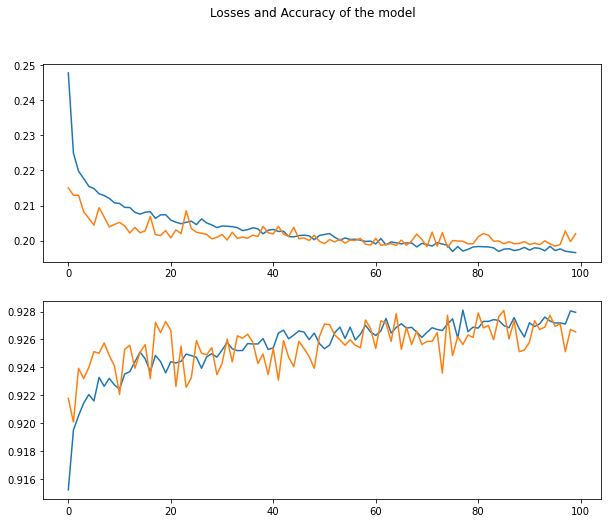

In [68]:
df_result_3 = pd.DataFrame(model.history.history)

fig, (ax1, ax2) = plt.subplots(2)
fig.suptitle('Losses and Accuracy of the model')
ax1.plot(df_result_3[['loss','val_loss']])
ax2.plot(df_result_3[['accuracy','val_accuracy']])

By applying callbacks and dropout, the model performs better.

### Model #4 - Hyperparameter Tuning using Keras Tuner

In [76]:
def model_builder(hp):
    hp_units = hp.Int('units', min_value=32, max_value=512, step=32)
    drp_units = hp.Choice('rate', values=[0.2, 0.3, 0.4, 0.5])
    
    model = Sequential()
    model.add(Dense(units=hp_units, input_shape=[103], activation='relu'))
    model.add(Dropout(rate=drp_units))
    model.add(Dense(units=hp_units, activation='relu'))
    model.add(Dropout(rate=drp_units))
    model.add(Dense(units=hp_units, activation='relu'))
    model.add(Dropout(rate=drp_units))
    model.add(Dense(1, activation='sigmoid'))

    hp_learning_rate = hp.Choice('learning_rate', values=[1e-2, 1e-3, 1e-4])


    model.compile(optimizer=keras.optimizers.Adam(learning_rate=hp_learning_rate),
                loss='binary_crossentropy',
                metrics='accuracy')

    return model

In [77]:
tuner = kt.RandomSearch(
    model_builder,
    objective='val_accuracy',
    max_trials=5)

INFO:tensorflow:Reloading Oracle from existing project .\untitled_project\oracle.json
INFO:tensorflow:Reloading Tuner from .\untitled_project\tuner0.json


In [78]:
early_stop = EarlyStopping(monitor='val_loss',mode='min', verbose = 1, patience=25)

In [81]:
tuner.search(X_train.values, y_train, epochs=20, validation_data = (X_test_new, y_test), callbacks=[early_stop])

best_hps=tuner.get_best_hyperparameters(num_trials=1)[0]

print(f"""
The hyperparameter search is complete. The optimal number of units in the first densely-connected
layer is {best_hps.get('units')} and the optimal learning rate for the optimizer
is {best_hps.get('learning_rate')}.
""")

INFO:tensorflow:Oracle triggered exit

The hyperparameter search is complete. The optimal number of units in the first densely-connected
layer is 256 and the optimal learning rate for the optimizer
is 0.0001.



In [82]:
best_hyperparameter = tuner.get_best_hyperparameters(num_trials=1)[0]
best_hyperparameter.values

{'units': 256, 'rate': 0.4, 'learning_rate': 0.0001}

In [83]:
best_model = tuner.get_best_models(num_models=1)[0]
best_model.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense (Dense)               (None, 256)               26624     
                                                                 
 dropout (Dropout)           (None, 256)               0         
                                                                 
 dense_1 (Dense)             (None, 256)               65792     
                                                                 
 dropout_1 (Dropout)         (None, 256)               0         
                                                                 
 dense_2 (Dense)             (None, 256)               65792     
                                                                 
 dropout_2 (Dropout)         (None, 256)               0         
                                                                 
 dense_3 (Dense)             (None, 1)                 2

In [86]:
final_model = tuner.hypermodel.build(best_hyperparameter)
final_model.fit(X_train_new.values,y_train, 
                    validation_data = (X_test_new.values, y_test), epochs=15, callbacks = [early_stop])

Epoch 1/15
2208/2208 [==============================] - 14s 6ms/step - loss: 0.2413 - accuracy: 0.9164 - val_loss: 0.2172 - val_accuracy: 0.9212
Epoch 2/15
2208/2208 [==============================] - 12s 6ms/step - loss: 0.2201 - accuracy: 0.9209 - val_loss: 0.2128 - val_accuracy: 0.9232
Epoch 3/15
2208/2208 [==============================] - 13s 6ms/step - loss: 0.2143 - accuracy: 0.9222 - val_loss: 0.2093 - val_accuracy: 0.9235
Epoch 4/15
2208/2208 [==============================] - 15s 7ms/step - loss: 0.2123 - accuracy: 0.9230 - val_loss: 0.2064 - val_accuracy: 0.9238
Epoch 5/15
2208/2208 [==============================] - 15s 7ms/step - loss: 0.2097 - accuracy: 0.9240 - val_loss: 0.2058 - val_accuracy: 0.9237
Epoch 6/15
2208/2208 [==============================] - 16s 7ms/step - loss: 0.2079 - accuracy: 0.9250 - val_loss: 0.2062 - val_accuracy: 0.9248
Epoch 7/15
2208/2208 [==============================] - 12s 6ms/step - loss: 0.2069 - accuracy: 0.9254 - val_loss: 0.2098 - val_ac

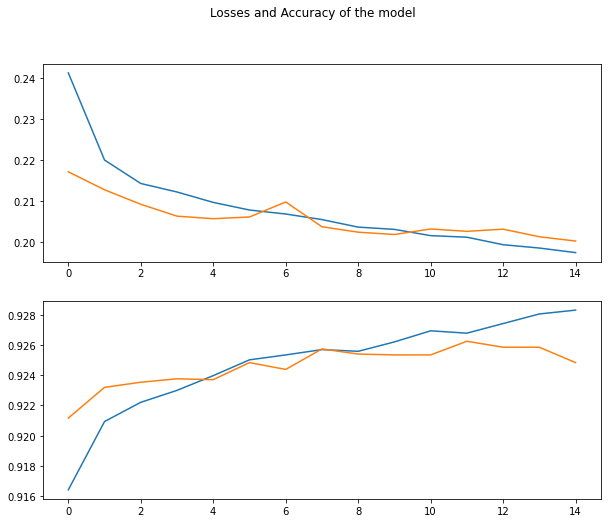

In [87]:
df_final_model = pd.DataFrame(final_model.history.history)

fig, (ax1, ax2) = plt.subplots(2)
fig.suptitle('Losses and Accuracy of the model')
ax1.plot(df_final_model[['loss','val_loss']])
ax2.plot(df_final_model[['accuracy','val_accuracy']])

After performing hyperparameter tuning:
- The values of the losses and accuracy of the training and testing data are somewhat close with each other 
- The refined model does not encountering overfitting as compared with the previous models.

In [91]:
# save model
joblib.dump(final_model, '../Model/final_model.pkl')

INFO:tensorflow:Assets written to: ram://0f003cea-fdcb-4397-959f-fade9d959fd6/assets


['../Model/final_model.pkl']